In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


The Amazon dataset contains the customer reviews for all listed Electronics products spanning from May 1996 up to July 2014. There are a total of 1,689,188 reviews by a total of 192,403 customers on 63,001 unique products. The data dictionary is as follows:

* asin - Unique ID of the product being reviewed, string
* helpful - A list with two elements: the number of users that voted helpful, and the total number of users that voted on the review (including the not helpful votes), list
* overall - The reviewer's rating of the product, int64
* reviewText - The review text itself, string
* reviewerID - Unique ID of the reviewer, string
* reviewerName - Specified name of the reviewer, string
* summary - Headline summary of the review, string
* unixReviewTime - Unix Time of when the review was posted, string

In [2]:
import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", DeprecationWarning)

In [3]:
import os
import pandas as pd

In [4]:
url = "/content/drive/MyDrive/reviews_Electronics_5.json.gz"
data = pd.read_json(url, compression='gzip', lines=True)

In [71]:
df = data.copy()

Limiting the dataset size

In [72]:
df = df.iloc[:25000]

In [7]:
display(df.head(10))

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
0,AO94DHGC771SJ,0528881469,amazdnu,"[0, 0]",We got this GPS for my husband who is an (OTR)...,5,Gotta have GPS!,1370131200,"06 2, 2013"
1,AMO214LNFCEI4,0528881469,Amazon Customer,"[12, 15]","I'm a professional OTR truck driver, and I bou...",1,Very Disappointed,1290643200,"11 25, 2010"
2,A3N7T0DY83Y4IG,0528881469,C. A. Freeman,"[43, 45]","Well, what can I say. I've had this unit in m...",3,1st impression,1283990400,"09 9, 2010"
3,A1H8PY3QHMQQA0,0528881469,"Dave M. Shaw ""mack dave""","[9, 10]","Not going to write a long review, even thought...",2,"Great grafics, POOR GPS",1290556800,"11 24, 2010"
4,A24EV6RXELQZ63,0528881469,Wayne Smith,"[0, 0]",I've had mine for a year and here's what we go...,1,"Major issues, only excuses for support",1317254400,"09 29, 2011"
5,A2JXAZZI9PHK9Z,0594451647,"Billy G. Noland ""Bill Noland""","[3, 3]",I am using this with a Nook HD+. It works as d...,5,HDMI Nook adapter cable,1388707200,"01 3, 2014"
6,A2P5U7BDKKT7FW,0594451647,Christian,"[0, 0]",The cable is very wobbly and sometimes disconn...,2,Cheap proprietary scam,1398556800,"04 27, 2014"
7,AAZ084UMH8VZ2,0594451647,"D. L. Brown ""A Knower Of Good Things""","[0, 0]",This adaptor is real easy to setup and use rig...,5,A Perfdect Nook HD+ hook up,1399161600,"05 4, 2014"
8,AEZ3CR6BKIROJ,0594451647,Mark Dietter,"[0, 0]",This adapter easily connects my Nook HD 7&#34;...,4,A nice easy to use accessory.,1405036800,"07 11, 2014"
9,A3BY5KCNQZXV5U,0594451647,Matenai,"[3, 3]",This product really works great but I found th...,5,This works great but read the details...,1390176000,"01 20, 2014"


In [8]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   reviewerID      25000 non-null  object
 1   asin            25000 non-null  object
 2   reviewerName    24780 non-null  object
 3   helpful         25000 non-null  object
 4   reviewText      25000 non-null  object
 5   overall         25000 non-null  int64 
 6   summary         25000 non-null  object
 7   unixReviewTime  25000 non-null  int64 
 8   reviewTime      25000 non-null  object
dtypes: int64(2), object(7)
memory usage: 1.7+ MB
None


In [9]:
df.dropna(axis=0, inplace=True)

In [10]:
from datetime import datetime
condition = lambda row: datetime.fromtimestamp(row).strftime("%m-%d-%Y")
df["unixReviewTime"] = df["unixReviewTime"].apply(condition)

In [11]:
df.drop(labels="reviewTime", axis=1, inplace=True)
display(df.head())

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime
0,AO94DHGC771SJ,0528881469,amazdnu,"[0, 0]",We got this GPS for my husband who is an (OTR)...,5,Gotta have GPS!,06-02-2013
1,AMO214LNFCEI4,0528881469,Amazon Customer,"[12, 15]","I'm a professional OTR truck driver, and I bou...",1,Very Disappointed,11-25-2010
2,A3N7T0DY83Y4IG,0528881469,C. A. Freeman,"[43, 45]","Well, what can I say. I've had this unit in m...",3,1st impression,09-09-2010
3,A1H8PY3QHMQQA0,0528881469,"Dave M. Shaw ""mack dave""","[9, 10]","Not going to write a long review, even thought...",2,"Great grafics, POOR GPS",11-24-2010
4,A24EV6RXELQZ63,0528881469,Wayne Smith,"[0, 0]",I've had mine for a year and here's what we go...,1,"Major issues, only excuses for support",09-29-2011


In [12]:
print(df["reviewText"].iloc[10])

This item is just as was described in the original description, works without any issues to be seen. Good product


In [13]:
print(df.overall.unique())

[5 1 3 2 4]


In [14]:
df_eda = df.copy()

In [15]:
from textblob import TextBlob
df_eda.dropna(axis=0, inplace=True)
df_eda['polarity'] = df_eda['reviewText'].apply(lambda tweet: TextBlob(tweet).sentiment.polarity)

In [16]:
df_eda.isnull().sum()

reviewerID        0
asin              0
reviewerName      0
helpful           0
reviewText        0
overall           0
summary           0
unixReviewTime    0
polarity          0
dtype: int64

In [17]:
df_eda['review_length'] = df_eda['reviewText'].apply(lambda x: len(x))

In [18]:
df_eda['word_count'] = df_eda['reviewText'].apply(lambda x: len(x.split()))

In [19]:
def avg_word_length(x):
  words = x.split()
  word_len=0
  for word in words:
    word_len = word_len + len(word)
  try:
    z = word_len / len(words)
  except ZeroDivisionError:
    z = 0
  return z

In [20]:
df_eda['avg_word_length'] = df_eda['reviewText'].apply(lambda x: avg_word_length(x))

In [21]:
df_eda.head()

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,polarity,review_length,word_count,avg_word_length
0,AO94DHGC771SJ,0528881469,amazdnu,"[0, 0]",We got this GPS for my husband who is an (OTR)...,5,Gotta have GPS!,06-02-2013,0.265385,805,149,4.362416
1,AMO214LNFCEI4,0528881469,Amazon Customer,"[12, 15]","I'm a professional OTR truck driver, and I bou...",1,Very Disappointed,11-25-2010,0.062441,2175,427,4.051522
2,A3N7T0DY83Y4IG,0528881469,C. A. Freeman,"[43, 45]","Well, what can I say. I've had this unit in m...",3,1st impression,09-09-2010,0.099464,4607,846,4.397163
3,A1H8PY3QHMQQA0,0528881469,"Dave M. Shaw ""mack dave""","[9, 10]","Not going to write a long review, even thought...",2,"Great grafics, POOR GPS",11-24-2010,0.059561,2246,449,4.004454
4,A24EV6RXELQZ63,0528881469,Wayne Smith,"[0, 0]",I've had mine for a year and here's what we go...,1,"Major issues, only excuses for support",09-29-2011,-0.002932,1076,202,4.331683


In [ ]:
import scipy as stats
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objects as go
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [35]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [36]:
configure_plotly_browser_state() 
init_notebook_mode(connected=False)
df_eda['polarity'].iplot(kind='hist', color='blue', bins=50, xTitle='Polarity', yTitle='Count',title='Review Text Sentiment Polarity Distribution', linecolor='black')

In [37]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
df_eda['overall'].iplot(kind='hist', xTitle='Overall', yTitle='Count', title='Review Overall Distribution',linecolor='black')

In [38]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
df_eda['review_length'].iplot(kind='hist', xTitle='Review Length', yTitle='Count', title='Review Length Distribution',linecolor='black')

In [39]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
df_eda['word_count'].iplot(kind='hist', xTitle='Word Cout', yTitle='Count', title='Review Text Word Count Distribution',linecolor='black')

In [40]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
df_eda['avg_word_length'].iplot(kind='hist', xTitle='Average word length', yTitle='Count', title='Review Text Average word length Distribution',linecolor='black')

NLP Pre-Processing

In [73]:
sample_review = df["reviewText"].iloc[140]
print(sample_review)

Awesome price and quality. Simple and easy to install and fully equipped for installation. If you need a swing arm mount for medium size tv this is one I'd recommend.


HTML Entities

In [74]:
import html
decoded_review = html.unescape(sample_review)
print(decoded_review)

Awesome price and quality. Simple and easy to install and fully equipped for installation. If you need a swing arm mount for medium size tv this is one I'd recommend.


In [75]:
pattern = r"\&\#[0-9]+\;"
df["preprocessed"] = df["reviewText"].str.replace(pat=pattern, repl="", regex=True)
print(df["preprocessed"].iloc[1689])

Okay, since most of the printers don't come with cables any longer, you always need to purchase one separately.  A &quot;regular&quot; printer cable can cost around $20 and it can be difficult to plug and unplug correctly without breaking one or more of those tiny prongs.  So a USB cable is a great solution.  It costs less and it's easy to plug and unplug, especially if your computer has front-mounted USB ports.  I bought this one for my new HP LaserJet 1012 Printer and it works just fine.  For this price, it's a great bargain.


Extracting the root word

In [76]:
%%time
import re
import nltk
from nltk import word_tokenize, pos_tag
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import sent_tokenize
from nltk.corpus import wordnet
resources = ["wordnet", "stopwords", "punkt","averaged_perceptron_tagger", "maxent_treebank_pos_tagger"]
for resource in resources:
    try:
        nltk.data.find("tokenizers/" + resource)
    except LookupError:
        nltk.download(resource)
lemma = WordNetLemmatizer()
def lemmatize_word(tagged_token):
    """ Returns lemmatized word given its tag"""
    root = []
    for token in tagged_token:
        tag = token[1][0]
        word = token[0]
        if tag.startswith('J'):
            root.append(lemma.lemmatize(word, wordnet.ADJ))
        elif tag.startswith('V'):
            root.append(lemma.lemmatize(word, wordnet.VERB))
        elif tag.startswith('N'):
            root.append(lemma.lemmatize(word, wordnet.NOUN))
        elif tag.startswith('R'):
            root.append(lemma.lemmatize(word, wordnet.ADV))
        else:          
            root.append(word)
    return root
def lemmatize_doc(document):
    lemmatized_list = []
    tokenized_sent = sent_tokenize(document)
    for sentence in tokenized_sent:
        no_punctuation = re.sub(r"[`'\",.!?()]", " ", sentence)
        tokenized_word = word_tokenize(no_punctuation)
        tagged_token = pos_tag(tokenized_word)
        lemmatized = lemmatize_word(tagged_token)
        lemmatized_list.extend(lemmatized)
    return " ".join(lemmatized_list)
df["preprocessed"] = df["preprocessed"].apply(lambda row: lemmatize_doc(row))
print(df["preprocessed"].iloc[150])

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package maxent_treebank_pos_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package maxent_treebank_pos_tagger is already up-to-
[nltk_data]       date!
Good strong mount and quality hardware Includes all the different size screw require to attach to TV if yours doesn t have them or if you lose them There be just the right amount of resistance in the joint for it to stay where you want it but still easy to move around I mount a shelf above the TV to get the cable box out of the way and avoid have to run a long HDMI cable through the wall

Removing Accents

In [77]:
from unicodedata import normalize
remove_accent = lambda text: normalize("NFKD", text).encode("ascii", "ignore").decode("utf-8", "ignore")
df["preprocessed"] = df["preprocessed"].apply(remove_accent)

Removing Punctuations

In [78]:
pattern = r"[^\w\s]"
df["preprocessed"] = df["preprocessed"].str.replace(pat=pattern, repl=" ", regex=True)

Converting to Lower Case

In [79]:
df["preprocessed"] = df["preprocessed"].str.lower()

Removing Stop Words

In [80]:
from nltk.corpus import stopwords
stop_words = stopwords.words("english")
stop_words = [word.replace("\'", "") for word in stop_words]
print(f"sample stop words: {stop_words[:15]} \n")
remove_stop_words = lambda row: " ".join([token for token in row.split(" ") if token not in stop_words])
df["preprocessed"] = df["preprocessed"].apply(remove_stop_words)
print(df["preprocessed"].iloc[16])

sample stop words: ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', 'youre', 'youve', 'youll', 'youd', 'your', 'yours'] 

go target barnes noble instead pay   25 still huge markup consider make thing 50 cent bad option need one price gouge pure simple


Removing Extra Spaces

In [81]:
pattern = r"[\s]+"
df["preprocessed"] = df["preprocessed"].str.replace(pat=pattern, repl=" ", regex=True)

Tokenization

In [82]:
corpora = df["preprocessed"].values
tokenized = [corpus.split(" ") for corpus in corpora]

Phrase Modeling

In [83]:
from gensim.models import Phrases
from gensim.models.phrases import Phraser
bi_gram = Phrases(tokenized, min_count=1, threshold=50)
tri_gram = Phrases(bi_gram[tokenized], min_count=2, threshold=50)

Unigrams

In [84]:
uni_gram_tokens = set([token for text in tokenized for token in text])
uni_gram_tokens = set(filter(lambda x: x != "", uni_gram_tokens))

Bigrams

In [85]:
bigram_min = bi_gram.min_count
bi_condition = lambda x: x[1] >= bigram_min
bi_gram_tokens = dict(filter(bi_condition, bi_gram.vocab.items()))
bi_gram_tokens = set([token.decode("utf-8") for token in bi_gram_tokens])
bi_grams_only = bi_gram_tokens.difference(uni_gram_tokens)
print(list(bi_grams_only))

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [86]:
tokenized = [list(filter(lambda x: len(x) > 1, document)) for document in tokenized]

Creating the Vocabulary

In [87]:
from gensim.corpora.dictionary import Dictionary
vocabulary = Dictionary(tokenized)
vocabulary_keys = list(vocabulary.token2id)[0:10]
for key in vocabulary_keys:
    print(f"ID: {vocabulary.token2id[key]}, Token: {key}")

ID: 0, Token: address
ID: 1, Token: around
ID: 2, Token: arrive
ID: 3, Token: back
ID: 4, Token: bad
ID: 5, Token: big
ID: 6, Token: come
ID: 7, Token: contact
ID: 8, Token: could
ID: 9, Token: day


Bag Of Words

In [88]:
bow = [vocabulary.doc2bow(doc) for doc in tokenized]
for idx, freq in bow[0]:
    print(f"Word: {vocabulary.get(idx)}, Frequency: {freq}")

Word: address, Frequency: 1
Word: around, Frequency: 1
Word: arrive, Frequency: 1
Word: back, Frequency: 1
Word: bad, Frequency: 1
Word: big, Frequency: 2
Word: come, Frequency: 1
Word: contact, Frequency: 1
Word: could, Frequency: 1
Word: day, Frequency: 1
Word: earlier, Frequency: 1
Word: ease, Frequency: 2
Word: ect, Frequency: 1
Word: email, Frequency: 2
Word: exception, Frequency: 1
Word: exchange, Frequency: 1
Word: expect, Frequency: 1
Word: freeze, Frequency: 2
Word: get, Frequency: 1
Word: glitch, Frequency: 1
Word: gps, Frequency: 1
Word: great, Frequency: 2
Word: however, Frequency: 1
Word: husband, Frequency: 1
Word: impressed, Frequency: 2
Word: instruction, Frequency: 1
Word: love, Frequency: 1
Word: luck, Frequency: 1
Word: memory, Frequency: 1
Word: million, Frequency: 1
Word: minute, Frequency: 1
Word: normal, Frequency: 1
Word: nothing, Frequency: 1
Word: one, Frequency: 1
Word: option, Frequency: 1
Word: otr, Frequency: 1
Word: person, Frequency: 1
Word: probably, Fr

TF-IDF Model

In [89]:
from gensim.models.tfidfmodel import TfidfModel
tfidf = TfidfModel(bow)
for idx, weight in tfidf[bow[0]]:
    print(f"Word: {vocabulary.get(idx)}, Weight: {weight:.3f}")

Word: address, Weight: 0.110
Word: around, Weight: 0.060
Word: arrive, Weight: 0.102
Word: back, Weight: 0.058
Word: bad, Weight: 0.073
Word: big, Weight: 0.135
Word: come, Weight: 0.050
Word: contact, Weight: 0.116
Word: could, Weight: 0.058
Word: day, Weight: 0.065
Word: earlier, Weight: 0.153
Word: ease, Weight: 0.235
Word: ect, Weight: 0.190
Word: email, Weight: 0.224
Word: exception, Weight: 0.135
Word: exchange, Weight: 0.144
Word: expect, Weight: 0.072
Word: freeze, Weight: 0.272
Word: get, Weight: 0.029
Word: glitch, Weight: 0.153
Word: gps, Weight: 0.115
Word: great, Weight: 0.061
Word: however, Weight: 0.067
Word: husband, Weight: 0.139
Word: impressed, Weight: 0.231
Word: instruction, Weight: 0.103
Word: love, Weight: 0.064
Word: luck, Weight: 0.119
Word: memory, Weight: 0.084
Word: million, Weight: 0.160
Word: minute, Weight: 0.085
Word: normal, Weight: 0.101
Word: nothing, Weight: 0.084
Word: one, Weight: 0.030
Word: option, Weight: 0.092
Word: otr, Weight: 0.227
Word: per

Word Embedding for Feature Engineering

In [90]:
%%time
import numpy as np
from gensim.models import word2vec
np.set_printoptions(suppress=True)
feature_size = 100
context_size = 20
min_word = 1
word_vec= word2vec.Word2Vec(tokenized, size=feature_size, \
                            window=context_size, min_count=min_word, \
                            iter=50, seed=42)

CPU times: user 4min, sys: 1.07 s, total: 4min 1s
Wall time: 2min 7s


Final Dataframe

In [91]:
word_vec_unpack = [(word, idx.index) for word, idx in \
                   word_vec.wv.vocab.items()]
tokens, indexes = zip(*word_vec_unpack)
word_vec_df = pd.DataFrame(word_vec.wv.syn0[indexes, :], index=tokens)
display(word_vec_df.head())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
get,0.454530,0.574109,0.659510,-1.525207,-3.134348,0.556822,3.468518,-0.107322,0.245507,-1.593060,-0.162626,-1.213280,0.760676,-3.207019,-0.436402,1.637513,-2.081032,-0.303001,-1.925538,0.441310,-1.573873,2.631028,-0.238831,-0.038571,0.940429,-1.322893,-0.520218,0.071098,0.513056,-2.083827,-0.886426,1.729618,0.055706,-3.260600,-0.187448,0.094120,-1.392771,-0.329118,0.205484,-1.627989,...,0.253934,0.022171,0.333047,0.375782,-2.893389,0.889442,1.842429,-1.947781,0.788136,-0.324232,0.012263,-1.086610,1.804119,-1.104290,-0.391217,0.268855,-0.099454,-0.011812,1.581170,0.483199,-0.335362,-1.446632,0.858000,1.548719,1.929527,2.091225,-1.317736,0.393421,-1.156041,1.779925,-1.758943,0.122901,-1.009953,-0.793848,1.501166,3.260998,0.571902,0.473654,2.160870,-0.218651
gps,0.786251,0.552625,3.503824,-1.905348,-2.584859,1.254122,9.646479,4.519469,0.864549,2.005249,1.143155,8.365170,-5.244740,4.792463,-6.004142,-2.407486,1.417513,0.376317,-3.271271,5.761950,-4.104809,-0.249414,7.394733,3.210834,2.357656,-4.717651,-0.432681,-1.394067,-3.256793,1.468713,0.286915,1.175108,0.403087,-0.344980,-0.536127,0.845056,-1.854806,-0.994603,5.978996,-2.209315,...,3.980658,0.979673,-4.962028,4.763216,3.087513,-0.640379,1.274991,-5.002254,-1.441961,-2.772816,-3.689877,2.049385,-2.168760,1.022474,-5.440098,7.703615,-4.482545,-4.924014,3.306709,6.212594,0.328759,-2.692183,1.394612,7.221735,-3.692077,-3.996487,2.710444,3.637650,-0.675165,0.513707,-5.670677,-2.168640,-2.974744,4.347995,1.250397,-5.508961,-3.101680,2.833750,2.264698,1.546245
husband,1.896057,0.403687,1.550327,-4.887475,2.471968,-0.767534,2.916552,1.468163,1.854115,-1.151090,-1.217347,-3.367901,-0.074274,-0.572592,0.930327,0.867314,0.208289,-2.586302,1.063294,-0.422769,-3.259890,3.233783,-2.719190,0.065017,-0.564154,-0.479027,0.378189,-1.567032,-5.073907,0.799158,0.443004,1.930868,0.072044,-2.157751,-0.355745,-2.149902,-2.534918,-0.055805,0.995540,1.208984,...,0.108036,2.270797,-1.043307,-0.327493,-0.342450,-0.510299,-1.034900,2.028955,-5.297382,0.409249,4.842501,-3.150147,0.473576,0.042568,-0.681892,0.371830,2.014739,-1.506498,-1.628603,2.439590,-3.694417,1.529454,-0.022546,-0.689339,2.435859,2.275036,-0.851590,3.266468,0.986781,-0.411800,0.514790,0.310842,-1.183839,1.583712,-2.479548,-3.796841,-0.737106,-0.940535,6.878712,1.456921
otr,-0.080909,0.360842,0.381258,-0.371452,0.221823,-0.729111,0.040851,-0.126932,-0.381425,-0.251546,0.327245,1.153205,-0.109783,-0.174229,0.249032,-0.330983,0.019703,0.053390,0.235710,-0.231796,0.050403,-0.133415,-0.297469,0.279280,-0.255701,0.234746,-0.006953,-0.241120,-0.350746,-0.124260,0.035872,-0.012418,0.181774,-0.101600,0.368739,0.306524,-0.023548,0.612309,0.318340,0.075085,...,-0.230843,0.865972,0.179795,0.535425,0.121353,0.036382,-0.078533,0.092322,0.274575,-0.097093,0.533579,0.803462,-0.271068,-0.684665,-0.047374,-0.075509,0.086584,-0.569170,-0.065436,0.219157,-0.808121,0.148440,0.140639,-0.122427,-0.362608,-0.296961,-0.362725,0.079734,-0.100553,0.503853,0.214819,-0.299341,-0.509168,0.736143,0.651505,-0.408265,-0.114723,0.374572,-0.165638,-0.085672
road,0.127561,1.714097,2.053975,0.262552,0.713751,1.081672,0.434108,-0.026610,1.628124,4.802650,-2.480046,4.211778,-3.973652,0.525935,-3.603216,-0.840820,0.475494,1.238175,-3.536832,1.468912,-1.762747,-3.708507,4.427956,-0.220261,3.804400,1.851303,2.235417,-0.542841,-2.346112,-0.332137,-0.234474,-3.445282,0.134991,-3.661195,-4.581547,1.437062,0.513216,1.103696,0.797151,-1.469606,...,-3.886513,4.791403,0.039504,0.434948,2.453694,-0.740153,-0.219945,-2.791173,-0.711202,-1.742168,2.430106,3.081373,-1.203852,-3.340889,-4.189533,0.075338,0.089576,-0.428649,3.025872,1.081608,-1.489598,2.730710,1.323393,3.024685,0.737532,-3.413072,-1.468448,0.346908,3.270142,2.702931,-4.619865,-4.108827,-2.3

In [92]:
%%time
tokenized_array = np.array(tokenized)
model_array = np.array([word_vec_df.loc[doc].mean(axis=0) for doc in tokenized_array])

CPU times: user 20.9 s, sys: 205 ms, total: 21.1 s
Wall time: 20.9 s


In [93]:
model_df = pd.DataFrame(model_array)
model_df["label"] = df["overall"]
display(model_df.head())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,label
0,-0.281281,0.501863,1.233278,-1.264272,-0.715733,-0.118102,1.474254,0.355275,0.779477,0.818247,0.035464,0.201997,-0.596280,-0.229717,0.251547,-0.556140,0.172512,0.135757,-0.260887,0.137005,-0.061569,-0.046530,0.507826,0.957726,-0.548906,-0.694104,-0.598890,0.492215,0.499472,0.204323,-0.110416,-0.580020,0.342684,-0.446771,-0.302976,0.093832,-1.294196,-0.012782,1.137399,-0.481384,...,0.806152,-0.374952,0.333494,0.394585,0.649636,0.913036,-0.463100,0.811880,0.207522,0.375077,-0.571348,0.060627,0.035274,-0.752371,0.135258,-0.750422,-0.317253,0.884701,0.284470,-0.116145,-0.019263,0.053247,0.652309,-0.273318,-0.285684,-0.323685,0.068532,-0.130667,0.191999,0.387306,-0.119069,-0.723807,-0.328607,0.702918,-0.249555,-0.680694,0.093205,0.995708,-0.075894,5
1,0.500894,0.945475,1.221758,-0.971738,-0.314861,0.391253,0.739170,0.052271,0.060407,0.718835,0.044608,0.392249,-0.519652,-0.204191,-0.002643,-0.566371,1.034849,0.278479,-0.501298,0.507942,0.074886,0.190797,0.313685,0.776381,0.698335,0.354931,-0.729429,0.153386,0.990102,0.170035,-0.089528,-0.529676,0.508086,-0.923841,0.262700,-0.211441,-0.767439,0.460350,0.194781,-1.462207,...,0.936352,-0.411358,0.578318,0.199886,0.108865,0.312081,-0.581210,0.577539,-0.169191,-0.059494,-0.202875,0.587078,-0.452579,-0.518424,0.231501,-0.402405,-0.283100,0.370658,1.204140,-0.163102,0.044094,0.053392,0.581043,0.260310,-0.411490,-0.134462,0.013135,0.176678,0.565980,-0.255340,-0.076121,-0.581058,-0.000245,0.654480,0.370695,0.183002,0.122306,0.025252,0.207459,1
2,0.318464,0.308644,0.246766,-0.532685,-0.183252,-0.184864,0.478499,0.309739,0.228556,0.298068,0.025543,0.204055,-1.004056,0.135603,-0.145763,-0.098159,0.622001,0.450658,-0.807456,0.576746,-0.186085,0.391448,0.775930,0.857298,0.666990,0.073927,-0.569082,0.148131,0.742744,0.648853,0.274710,-0.922020,0.230831,-0.204647,0.161321,-0.342197,-0.429364,0.323107,1.092413,-0.784596,...,0.787293,-0.492023,0.736855,1.048338,-0.166309,0.573373,-0.986845,0.575348,-0.685244,-0.316328,0.113261,0.335782,-0.869775,-0.487878,0.747768,-0.828146,-0.669125,0.331090,1.064519,0.509088,0.073661,0.679799,0.537621,-0.017867,-0.737474,-0.026676,0.408898,-0.166594,-0.532133,-0.606533,-0.621421,0.168436,0.211451,0.548199,0.084401,-0.346465,0.200968,-0.419299,0.028407,3
3,0.022604,0.669827,0.597699,-0.483391,-0.398201,0.179275,0.986904,-0.092654,0.186833,0.000494,0.155737,0.102020,-0.845160,-0.480283,-0.512058,-0.053670,0.434935,0.304234,-0.677023,0.438792,0.026084,0.162188,0.686999,0.620592,0.222461,-0.465439,-0.686752,0.139936,0.644788,0.641844,0.454552,-0.390037,0.081265,-0.729309,0.212165,-0.170093,-0.589734,0.524010,0.729549,-0.787548,...,0.302399,-0.574988,0.620817,0.505224,0.303644,0.592169,-0.565563,0.701628,0.023723,-0.193813,-0.592326,0.571831,-0.194690,-0.470252,0.319198,-0.686358,-0.204077,0.652858,0.920813,0.315888,0.140979,0.290999,0.566961,0.125224,-0.641664,-0.217504,0.276333,-0.378199,0.122069,-0.780359,-0.262179,-0.171163,-0.079730,0.765561,0.071315,-0.798660,0.110319,0.204233,-0.267855,2
4,0.429489,0.465769,0.449129,-0.254548,-0.127179,0.337674,1.230861,0.460793,0.100945,0.676618,0.318545,0.697797,-0.469462,-0.352057,-0.138860,-1.129990,0.938713,0.305963,-0.364112,1.078754,-0.417890,0.280973,1.073484,0.641472,0.540635,-0.423304,-1.126283,0.202799,0.484194,0.247957,-0.339164,-0.941980,0.447655,-0.640617,0.355755,-0.292212,-0.990679,0.617697,1.287733,-0.951141,...,0.914604,-0.809447,0.591676,0.635432,0.436631,0.742710,-0.273118,0.715608,-1.218707,-0.225668,0.010751,0.018935,-1.091872,-0.153541,0.707041,-0.529435,-0.701297,0.405607,1.632819,0.201326,-0.254314,0.525627,0.458820,0.182181,-1.246310,0.197489,0.235374,0.140479,-0.070003,-0.801017,-0.350829,-0.650087,0.612453,1.291658,-0.217887,0.440904,0.492091,-0.454053,0.136512,1


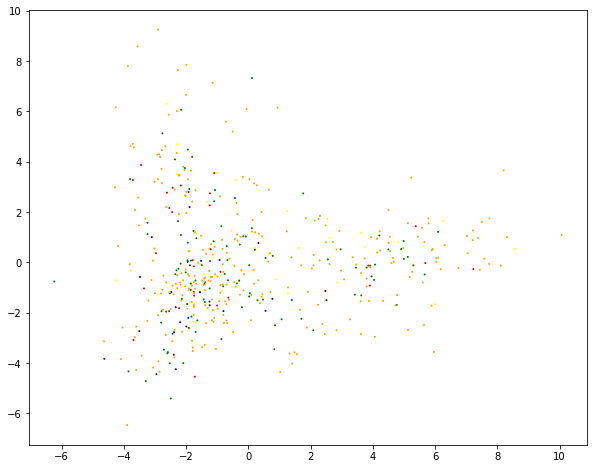

In [94]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
pca_df = model_df.reset_index()
pca_df = model_df.dropna(axis=0).iloc[:,1:]
pca_df = pca_df.iloc[::50]
pca = PCA(n_components=25, random_state=42)
pca = pca.fit_transform(pca_df.iloc[:, :-1])
labels = pca_df["label"]
x_axis = pca[:,0]
y_axis = pca[:,1]
color_map = pca_df["label"].map({1:"blue", \
                                 2:"red", \
                                 3:"yellow", \
                                 4:"green", \
                                 5:"orange"})
f, axes = plt.subplots(figsize=(10,8))
plt.scatter(x_axis, y_axis, color=color_map, s=1)
plt.show()

Exploratory Data Analysis

More on Word2Vec

In [95]:
word_bank = ["nook", "phone", "tv", "good", "price"]
for word in word_bank[:]:
    related_vec = word_vec.wv.most_similar(word, topn=5)
    related_words = np.array(related_vec)[:,0]
    word_bank.extend(related_words)
    print(f"{word}: {related_words}")

nook: ['touchscreen' 'kindle' 'ebooks' 'book' 'ereader']
phone: ['telephone' 'ghz' 'headset' 'phonescons' '900mhz']
tv: ['television' 'tvs' 'articulating' 'lg' 'hdtv']
good: ['decent' 'great' 'excellent' 'well' 'reasonable']
price: ['cost' 'priced' 'pricing' 'defiantly' 'represented']


t-SNE

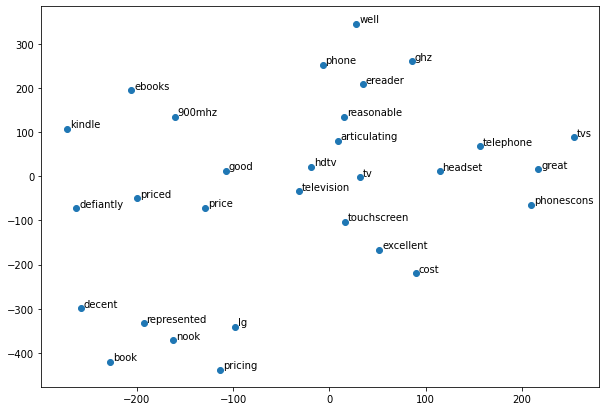

In [96]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, perplexity=5, n_iter=1000, random_state=42)
sample_vecs = word_vec.wv[set(word_bank)]
sample_tsne = tsne.fit_transform(sample_vecs)
tsne_x = sample_tsne[:, 0]
tsne_y = sample_tsne[:, 1]
f, axes = plt.subplots(figsize=(10,7))
ax = plt.scatter(x=tsne_x, y=tsne_y)
for label, x, y in zip(word_bank, tsne_x, tsne_y):
    plt.annotate(label, xy=(x+3, y+3))
plt.show()

Word Algebra

In [97]:
word_vec.wv.most_similar(positive=["books", "touchscreen"], \
                      negative=[], topn=1)

[('nook', 0.5888211131095886)]

In [98]:
word_vec.wv.most_similar(positive=["cheap"], \
                      negative=["quality"], topn=1)

[('worse', 0.39250731468200684)]

In [99]:
word_vec.wv.most_similar(positive=["tablet"], \
                      negative=["phone"], topn=1)

[('ereader', 0.42076146602630615)]

Named-Entity Recognition

In [100]:
helpful = df["helpful"].tolist()
most_helpful = max(helpful, key=lambda x: x[0])
most_helpful_idx = df["helpful"].astype(str) == str(most_helpful)
most_helpful_idx = df[most_helpful_idx].index
most_helpful_text = df["reviewText"].iloc[most_helpful_idx].values[0]
print(most_helpful_text)

No it's not especially if you take into account its intended users. If you use a Canon digital SLR and are satisfied with the kit lens (18-55) then buying this lens can be the perfect next step for you. Practically speaking, you will be able to increase your zoom reach to the point where you can A) photograph birds in moderately distant trees, B) be able to zoom in on the other side of a valley and frame something of your interest. Those are just two examples. One thing you will NOT be able to do effectively with this lens, however, is to take sport shots with it. How so? Consider some of the following weakness:*At 300mm zoom range the highest aperture is limited to 5.6 (You will have to use very slow shutter speed to snap fast action shots; remember the inverse relation between aperture and shutter speed.)*The lens size/weight combination makes it hard to hold steady when attached to a camera like the Rebel XT*Slow and often inaccurate auto focus (I just don't understand why Canon mak

In [101]:
%%time
import spacy
from collections import defaultdict
ner = spacy.load("en")
ner_helpful = ner(most_helpful_text)
ner_dict = defaultdict(list)
for entity in ner_helpful.ents:
    ner_dict[entity.label_].append(entity)
for NER, name in ner_dict.items():
    print(f"{NER}:\n{name}\n")

DATE:
[18-55, 18-55]

CARDINAL:
[two, One, 5.6, 2.8, 3X, 4X, 300/75=4, TWO, 400, 800, one]

QUANTITY:
m, 28mm]

GPE:
[Canon, Canon]

NORP:
[USM, Chromatic]

MONEY:
[20]

ORG:
[Amazon, Shoot]

PRODUCT:
[Point, 55/18=]

ORDINAL:
[First, Second]

CPU times: user 584 ms, sys: 14 ms, total: 599 ms
Wall time: 598 ms


In [102]:
from spacy import displacy
displacy.render(ner_helpful, style="ent", jupyter=True)

Dependency Tree

In [103]:
def ner_displacy(sentence):
    ner_sentence = ner(sentence)
    displacy.render(ner_sentence, jupyter=True, \
                    options={"compact": False, \
                             "distance": 90, \
                             "word_spacing":20, \
                             "arrow_spacing":10, \
                             "arrow_stroke": 2, \
                             "arrow_width": 5})
for sentence in most_helpful_text.split(".")[0:3]:
    ner_displacy(sentence)

Topic Modeling

In [104]:
%%time
import multiprocessing
from gensim.models.ldamulticore import LdaMulticore
cores = multiprocessing.cpu_count()
num_topics = 10
bow_lda = LdaMulticore(bow, num_topics=num_topics, id2word=vocabulary, \
                       passes=5, workers=cores, random_state=42)
for token, frequency in bow_lda.show_topic(0, topn=5):
    print(token, frequency)

player 0.016718877
sound 0.013848501
use 0.0130579565
speaker 0.012176319
one 0.01211539
CPU times: user 1min, sys: 3.89 s, total: 1min 4s
Wall time: 1min 33s


In [105]:
for topic in range(0, num_topics):
    print(f"\nTopic {topic+1}:")
    for token, frequency in bow_lda.show_topic(topic, topn=5):
        print(f" {token}, {frequency}")


Topic 1:
 player, 0.016718877479434013
 sound, 0.0138485012575984
 use, 0.013057956472039223
 speaker, 0.012176319025456905
 one, 0.012115390039980412

Topic 2:
 tape, 0.029932498931884766
 drive, 0.02229970693588257
 record, 0.013647899031639099
 use, 0.011761533096432686
 disk, 0.008684290573000908

Topic 3:
 camera, 0.05027197301387787
 picture, 0.018774552270770073
 use, 0.015224688686430454
 take, 0.015019209124147892
 digital, 0.012218496762216091

Topic 4:
 cable, 0.024607941508293152
 work, 0.0226718932390213
 use, 0.012441692873835564
 great, 0.010827706195414066
 need, 0.01069390308111906

Topic 5:
 case, 0.016060711815953255
 canon, 0.013273368589580059
 use, 0.011957647278904915
 bag, 0.01172701921314001
 well, 0.011569335125386715

Topic 6:
 sound, 0.03160253167152405
 headphone, 0.02146441489458084
 good, 0.017606718465685844
 speaker, 0.013924089260399342
 use, 0.011454615741968155

Topic 7:
 card, 0.062372755259275436
 product, 0.016843168064951897
 work, 0.01541029848

In [106]:
nan_list = model_df[model_df[0].isna()].index
nan_list = nan_list.tolist()
print(nan_list[0:5])

[149, 293, 1212, 4534, 4633]


In [107]:
print(*[tokenized[blank] for blank in nan_list[0:5]])

[] [] [] [] []


In [108]:
for blank in nan_list[0:5]:
    display(df["reviewText"].iloc[blank])

''

''

''

'A+++++++'

''

In [109]:
print(f"Original 'model_df' count: {len(model_df)}")
print(f"Final 'model_df' count: {len(model_df.dropna(axis=0))}")
model_df = model_df.dropna(axis=0)
display(model_df.head())

Original 'model_df' count: 25000
Final 'model_df' count: 24988


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,label
0,-0.281281,0.501863,1.233278,-1.264272,-0.715733,-0.118102,1.474254,0.355275,0.779477,0.818247,0.035464,0.201997,-0.596280,-0.229717,0.251547,-0.556140,0.172512,0.135757,-0.260887,0.137005,-0.061569,-0.046530,0.507826,0.957726,-0.548906,-0.694104,-0.598890,0.492215,0.499472,0.204323,-0.110416,-0.580020,0.342684,-0.446771,-0.302976,0.093832,-1.294196,-0.012782,1.137399,-0.481384,...,0.806152,-0.374952,0.333494,0.394585,0.649636,0.913036,-0.463100,0.811880,0.207522,0.375077,-0.571348,0.060627,0.035274,-0.752371,0.135258,-0.750422,-0.317253,0.884701,0.284470,-0.116145,-0.019263,0.053247,0.652309,-0.273318,-0.285684,-0.323685,0.068532,-0.130667,0.191999,0.387306,-0.119069,-0.723807,-0.328607,0.702918,-0.249555,-0.680694,0.093205,0.995708,-0.075894,5
1,0.500894,0.945475,1.221758,-0.971738,-0.314861,0.391253,0.739170,0.052271,0.060407,0.718835,0.044608,0.392249,-0.519652,-0.204191,-0.002643,-0.566371,1.034849,0.278479,-0.501298,0.507942,0.074886,0.190797,0.313685,0.776381,0.698335,0.354931,-0.729429,0.153386,0.990102,0.170035,-0.089528,-0.529676,0.508086,-0.923841,0.262700,-0.211441,-0.767439,0.460350,0.194781,-1.462207,...,0.936352,-0.411358,0.578318,0.199886,0.108865,0.312081,-0.581210,0.577539,-0.169191,-0.059494,-0.202875,0.587078,-0.452579,-0.518424,0.231501,-0.402405,-0.283100,0.370658,1.204140,-0.163102,0.044094,0.053392,0.581043,0.260310,-0.411490,-0.134462,0.013135,0.176678,0.565980,-0.255340,-0.076121,-0.581058,-0.000245,0.654480,0.370695,0.183002,0.122306,0.025252,0.207459,1
2,0.318464,0.308644,0.246766,-0.532685,-0.183252,-0.184864,0.478499,0.309739,0.228556,0.298068,0.025543,0.204055,-1.004056,0.135603,-0.145763,-0.098159,0.622001,0.450658,-0.807456,0.576746,-0.186085,0.391448,0.775930,0.857298,0.666990,0.073927,-0.569082,0.148131,0.742744,0.648853,0.274710,-0.922020,0.230831,-0.204647,0.161321,-0.342197,-0.429364,0.323107,1.092413,-0.784596,...,0.787293,-0.492023,0.736855,1.048338,-0.166309,0.573373,-0.986845,0.575348,-0.685244,-0.316328,0.113261,0.335782,-0.869775,-0.487878,0.747768,-0.828146,-0.669125,0.331090,1.064519,0.509088,0.073661,0.679799,0.537621,-0.017867,-0.737474,-0.026676,0.408898,-0.166594,-0.532133,-0.606533,-0.621421,0.168436,0.211451,0.548199,0.084401,-0.346465,0.200968,-0.419299,0.028407,3
3,0.022604,0.669827,0.597699,-0.483391,-0.398201,0.179275,0.986904,-0.092654,0.186833,0.000494,0.155737,0.102020,-0.845160,-0.480283,-0.512058,-0.053670,0.434935,0.304234,-0.677023,0.438792,0.026084,0.162188,0.686999,0.620592,0.222461,-0.465439,-0.686752,0.139936,0.644788,0.641844,0.454552,-0.390037,0.081265,-0.729309,0.212165,-0.170093,-0.589734,0.524010,0.729549,-0.787548,...,0.302399,-0.574988,0.620817,0.505224,0.303644,0.592169,-0.565563,0.701628,0.023723,-0.193813,-0.592326,0.571831,-0.194690,-0.470252,0.319198,-0.686358,-0.204077,0.652858,0.920813,0.315888,0.140979,0.290999,0.566961,0.125224,-0.641664,-0.217504,0.276333,-0.378199,0.122069,-0.780359,-0.262179,-0.171163,-0.079730,0.765561,0.071315,-0.798660,0.110319,0.204233,-0.267855,2
4,0.429489,0.465769,0.449129,-0.254548,-0.127179,0.337674,1.230861,0.460793,0.100945,0.676618,0.318545,0.697797,-0.469462,-0.352057,-0.138860,-1.129990,0.938713,0.305963,-0.364112,1.078754,-0.417890,0.280973,1.073484,0.641472,0.540635,-0.423304,-1.126283,0.202799,0.484194,0.247957,-0.339164,-0.941980,0.447655,-0.640617,0.355755,-0.292212,-0.990679,0.617697,1.287733,-0.951141,...,0.914604,-0.809447,0.591676,0.635432,0.436631,0.742710,-0.273118,0.715608,-1.218707,-0.225668,0.010751,0.018935,-1.091872,-0.153541,0.707041,-0.529435,-0.701297,0.405607,1.632819,0.201326,-0.254314,0.525627,0.458820,0.182181,-1.246310,0.197489,0.235374,0.140479,-0.070003,-0.801017,-0.350829,-0.650087,0.612453,1.291658,-0.217887,0.440904,0.492091,-0.454053,0.136512,1


Dealing with Unbalanced Data

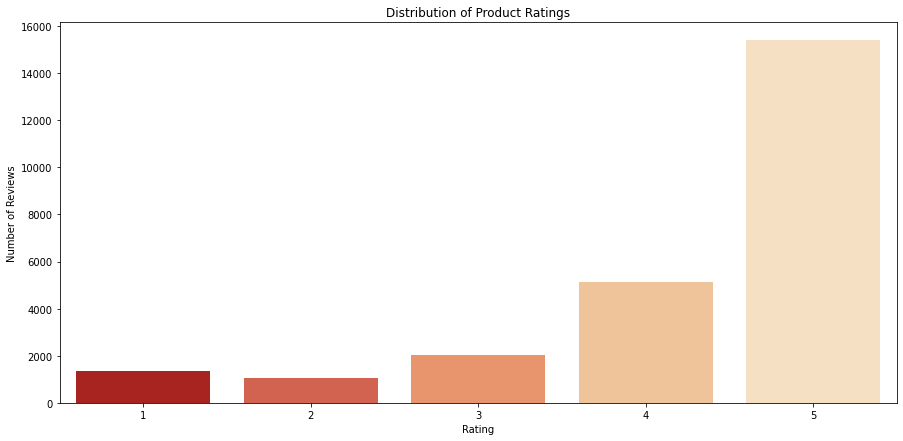

In [110]:
import seaborn as sns
f, axes = plt.subplots(figsize=(15,7))
ax = sns.countplot(x=df["overall"], palette="OrRd_r")
ax.set(title="Distribution of Product Ratings", \
       xlabel="Rating", ylabel="Number of Reviews")
plt.show()

In [111]:
majority = df["overall"] == 5
majority_ratio = len(df[majority]) / len(df)
print(f"{majority_ratio*100:.2f}%")

61.58%


Underrepresentation vs. Overrepresentation

In [112]:
count = len(model_df[model_df["label"] == 2])
print(f"Size of the most underrepresented class: {count}")

Size of the most underrepresented class: 1058


In [113]:
condition = model_df["label"] == 5
trimmed_df = model_df[condition].sample(n=count, random_state=42)
for rating in [1, 2, 3, 4]:
    condition = model_df["label"] == rating
    if len(model_df[condition]) >= count:
        add_df = model_df[condition].sample(n=count, random_state=42)
    else:
        add_df = model_df[condition]
    trimmed_df = pd.concat([trimmed_df, add_df], ignore_index=False)
for rating in [1, 2, 3, 4, 5]:
    class_size = len(trimmed_df[trimmed_df["label"] == rating])
    print(f"Size of Class {rating}: {class_size}")

Size of Class 1: 1058
Size of Class 2: 1058
Size of Class 3: 1058
Size of Class 4: 1058
Size of Class 5: 1058


In [114]:
trimmed_df = trimmed_df.sort_values(by="label")
display(trimmed_df.head())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,label
6733,-0.250923,0.236585,0.201118,-0.379918,-0.038274,0.846021,1.128037,-0.189083,0.718602,-0.301692,0.208672,-0.547711,-0.641857,-0.697146,0.772319,-0.053303,0.463923,1.186109,0.132353,0.379863,-0.129523,0.185225,0.989843,0.106549,0.055594,-1.217373,-0.161781,-0.093316,1.059896,0.569604,0.238765,-0.525236,0.304403,-0.846634,-0.645105,-0.620827,-1.439348,-0.489233,0.050815,0.033407,...,0.445538,0.262620,0.267270,1.044051,1.190475,0.104363,-0.049550,1.664569,-0.075477,0.177617,-0.336666,0.202892,-0.159962,0.533280,-0.278783,-0.763061,-0.010942,0.091609,0.206664,-0.371609,-0.875422,0.280955,0.398664,-0.131121,-0.638543,-0.424204,-0.751537,-0.362671,-0.195226,0.092203,0.196646,-0.335112,0.013524,0.993995,0.558420,0.841196,-0.623521,-0.035497,1.518688,1
2361,-0.494678,0.941005,0.651874,-0.126617,-1.229946,0.259936,0.280420,-0.034693,-0.135683,0.051406,0.590593,-1.022217,-0.435337,-0.699235,0.341798,0.490404,-0.010319,-0.250552,0.420433,0.360755,-1.061411,-0.565485,0.212349,-0.492584,-0.552042,0.338328,-0.515656,1.660475,0.002900,0.161038,0.806687,-0.658405,-0.402399,-0.170906,-0.651449,-1.070172,-0.866190,0.206885,0.351381,0.928346,...,0.224796,1.017172,-0.229876,0.463128,0.765651,0.697300,-0.364441,-0.435930,0.197627,-1.501950,-1.204799,0.658361,-0.287629,0.402897,0.248964,-0.515401,-0.191273,-0.054533,0.734694,-0.545199,0.511781,0.903692,0.037366,0.630202,-1.011756,0.167578,0.451508,0.223309,0.344127,0.363943,-0.344485,-0.579031,-0.687621,1.093376,0.176617,-0.647609,0.113366,0.203616,-0.302405,1
1398,-0.463789,0.837375,0.021096,-0.102455,-0.882585,0.311595,0.700484,-0.004413,-0.071801,0.455231,0.403714,-1.009603,-0.209570,-0.528616,0.089963,0.589429,0.566747,0.027174,0.138476,-0.048996,-0.800664,-0.343608,-0.112194,-0.348973,-0.539127,-0.133665,-0.540110,1.261738,0.513198,0.338796,0.335770,0.287813,0.502711,-0.974765,-0.635337,-1.114085,-0.756100,0.165994,0.289510,0.458618,...,0.349049,0.367886,0.593387,0.267270,0.667733,0.287080,-0.612233,-0.569809,-0.129402,-1.046622,-1.372157,0.309775,-0.061501,0.238896,0.277081,-0.647735,-0.255512,0.122844,0.352324,0.006871,0.154495,0.583051,0.701580,0.206253,-0.764950,0.666501,0.040780,0.401506,0.282413,0.034547,-0.000865,-0.372002,-0.223671,0.697167,-0.148148,-0.066646,0.533022,0.893998,0.061862,1
5647,-0.988504,0.591818,0.401112,-0.397547,-0.027003,0.989079,0.945758,0.135968,-0.772947,-0.003379,0.009322,1.310940,-0.100467,-0.193838,-0.009490,-1.635180,0.337465,-0.544330,-1.435708,0.934253,-0.223413,0.274188,0.726010,-0.534648,0.421534,0.171267,-1.201975,0.882155,0.849774,0.936957,-0.970450,-0.641273,1.828931,-0.081007,0.909429,0.545779,-0.757606,0.520855,-0.031473,-0.831701,...,0.712030,-1.016321,0.975235,0.572052,1.085159,-0.133220,-0.465786,0.896145,-0.207841,-0.230072,0.186626,-0.031961,-0.909315,1.616571,1.026068,-0.738181,-1.291581,-0.665275,1.016573,1.598342,0.576501,0.046370,-0.424886,0.232673,-0.404250,-0.316167,-0.727461,-0.178374,-1.437901,0.342127,0.924202,-0.853064,0.296395,0.230405,-0.148425,0.412749,-0.333605,-0.249633,0.309681,1
16437,0.569215,-1.341464,0.176490,1.825350,0.067834,1.368812,-0.427106,-0.347824,-0.767582,0.250692,0.318852,-1.283839,0.076764,-0.147260,-0.126332,0.868070,0.475841,-0.147256,-0.562739,1.201625,-0.995338,-0.138758,0.128774,0.757964,-1.680607,-1.148753,-1.257558,2.207705,-0.807212,-0.082341,0.709285,0.855805,-0.743806,0.543969,-1.396149,-0.975011,-0.492159,-1.030933,1.265051,1.305580,...,1.299262,-0.185033,0.478380,-1.274392,0.722549,-1.109291,-0.035830,1.298208,-1.957170,-1.313834,-0.287901,-0.661884,-0.699953,0.816629,-1.037362,0.683216,-0.260412,-0.305591,-0.384258,-1.423030,0.860531,0.064400,0.660299,2.386341,-1.467996,-0.944475,0.929695,-0.226103,0.096451,-1.068809,-1.185086,-2.902884,-0.959559,0.725753,2.200518

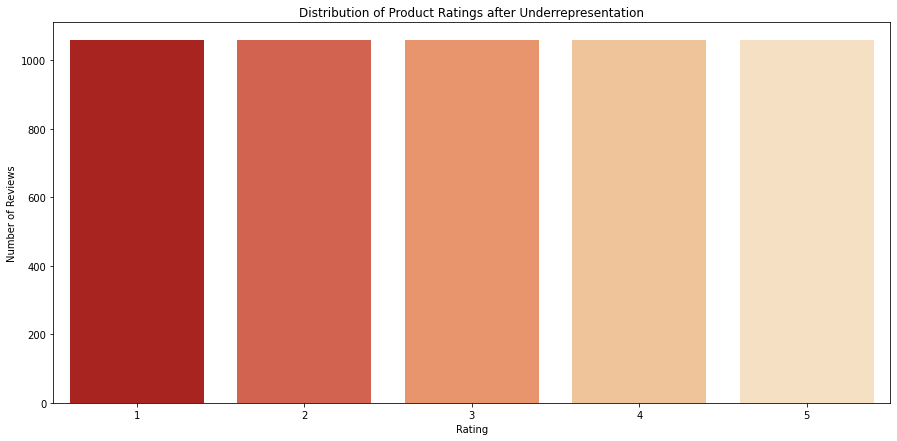

In [115]:
f, axes = plt.subplots(figsize=(15,7))
ax = sns.countplot(x=trimmed_df["label"], palette="OrRd_r")
ax.set(title="Distribution of Product Ratings after Underrepresentation", \
       xlabel="Rating", ylabel="Number of Reviews")
plt.show()

Train-Test-Split

In [116]:
from sklearn.model_selection import train_test_split
X = trimmed_df.iloc[:, :-1]
y = trimmed_df.iloc[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.25, random_state=42)

Scoring and Baseline

In [117]:
from sklearn import metrics
label_shape = np.shape(y_test)
y_baseline = np.full(label_shape, 5)
accuracy_baseline = metrics.accuracy_score(y_test, y_baseline)
f1_score_baseline = metrics.f1_score(y_test, y_baseline, average="micro")
print(f"Baseline Accuracy: {accuracy_baseline*100:.3f}%")
print(f"Baseline F1 Score: {f1_score_baseline:.3f}")

Baseline Accuracy: 19.955%
Baseline F1 Score: 0.200


Random Forest

In [118]:
from sklearn.model_selection import train_test_split
X = model_df.iloc[:, :-1]
y = model_df.iloc[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.25, random_state=42)

In [119]:
%%time
from sklearn.ensemble import RandomForestClassifier
forest = RandomForestClassifier(n_estimators=25, class_weight={1:10, 2:12, 3:7, 4:9, 5:1}, \
                                criterion="entropy", random_state=42)
forest.fit(X_train, y_train)

CPU times: user 12.5 s, sys: 33.6 ms, total: 12.5 s
Wall time: 12.5 s


In [120]:
y_pred = forest.predict(X_train)
accuracy = metrics.accuracy_score(y_train, y_pred)
f1_score = metrics.f1_score(y_train, y_pred, average="micro")
print(f"Training Set Accuracy: {accuracy*100:.3f}%")
print(f"Training Set F1 Score: {f1_score:.3f}")

Training Set Accuracy: 99.883%
Training Set F1 Score: 0.999


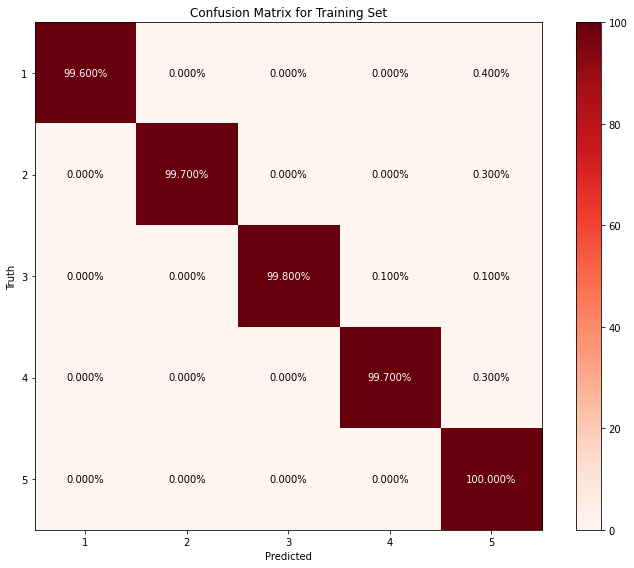

In [121]:
from sklearn.metrics import confusion_matrix
confusion_train = confusion_matrix(y_train, y_pred)
confusion_train = confusion_train.astype("float") / \
                   confusion_train.sum(axis=1)[:, np.newaxis]
confusion_train = np.around(confusion_train, decimals=3)*100
f, axes = plt.subplots(figsize=(10,8))
im = axes.imshow(confusion_train, interpolation="nearest", cmap=plt.cm.Reds)
axes.figure.colorbar(im, ax=axes)
axes.set(title="Confusion Matrix for Training Set", \
         xticks=np.arange(confusion_train.shape[1]), \
         yticks=np.arange(confusion_train.shape[0]), \
         xticklabels=range(1, 6), yticklabels=range(1, 6), \
         xlabel="Predicted", ylabel="Truth")
threshold = confusion_train.max()/1.5
for i in range(confusion_train.shape[0]):
    for j in range(confusion_train.shape[1]):
        axes.text(j, i, f"{confusion_train[i, j]:.3f}%",
                ha="center", va="center",
                color="white" if confusion_train[i, j] > threshold else "black")
f.tight_layout()
plt.show()

Cross-Validation

In [122]:
from sklearn.model_selection import cross_val_score
cross_val_accuracy = cross_val_score(forest, X_train, y_train, \
                               cv=3, scoring="accuracy")
cross_val_f1 = cross_val_score(forest, X_train, y_train, \
                               cv=3, scoring="f1_micro")
cross_val_accuracy = np.mean(cross_val_accuracy)
cross_val_f1 = np.mean(cross_val_f1)
print(f"Training Set Accuracy: {cross_val_accuracy*100:.3f}%")
print(f"Training Set F1 Score: {cross_val_f1:.3f}")

Training Set Accuracy: 61.822%
Training Set F1 Score: 0.618


XGBoost

In [123]:
%%time
import xgboost as xgb
y_train_shifted = y_train-1
y_test_shifted = y_test-1
train_set = xgb.DMatrix(X_train, label=y_train_shifted)
test_set = xgb.DMatrix(X_test, label=y_test_shifted)
parameters = {"max_depth": 10, "eta": 0.2, "silent": 1, \
              "objective": "multi:softprob", "num_class": 5}
boost = xgb.train(parameters, train_set, 100)

CPU times: user 5min 3s, sys: 423 ms, total: 5min 3s
Wall time: 2min 34s


In [124]:
y_pred = boost.predict(train_set)
y_pred = y_pred.argmax(axis=1)
y_pred = y_pred+1
accuracy = metrics.accuracy_score(y_train, y_pred)
f1_score = metrics.f1_score(y_train, y_pred, average="micro")
print(f"Training Set Accuracy: {accuracy*100:.3f}%")
print(f"Training Set F1 Score: {f1_score:.3f}")

Training Set Accuracy: 99.984%
Training Set F1 Score: 1.000


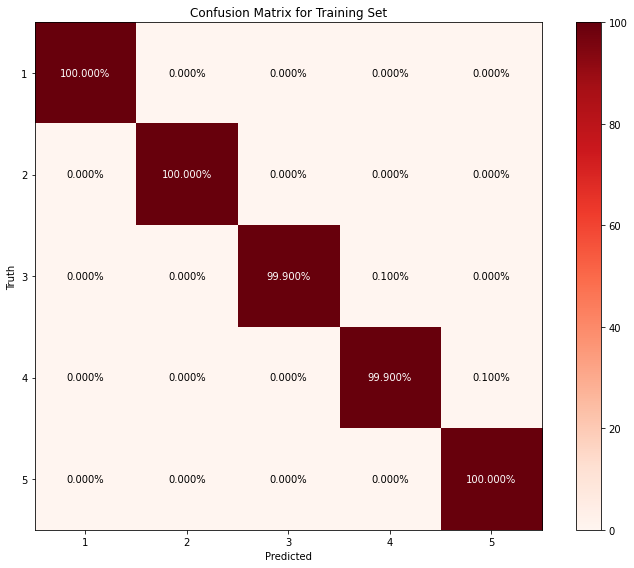

In [125]:
confusion_train = confusion_matrix(y_train, y_pred)
confusion_train = confusion_train.astype("float") / \
                   confusion_train.sum(axis=1)[:, np.newaxis]
confusion_train = np.around(confusion_train, decimals=3)*100
f, axes = plt.subplots(figsize=(10,8))
im = axes.imshow(confusion_train, interpolation="nearest", cmap=plt.cm.Reds)
axes.figure.colorbar(im, ax=axes)
axes.set(title="Confusion Matrix for Training Set", \
         xticks=np.arange(confusion_train.shape[1]), \
         yticks=np.arange(confusion_train.shape[0]), \
         xticklabels=range(1, 6), yticklabels=range(1, 6), \
         xlabel="Predicted", ylabel="Truth")
threshold = confusion_train.max()/1.5
for i in range(confusion_train.shape[0]):
    for j in range(confusion_train.shape[1]):
        axes.text(j, i, f"{confusion_train[i, j]:.3f}%",
                ha="center", va="center",
                color="white" if confusion_train[i, j] > threshold else "black")
f.tight_layout()
plt.show()

In [126]:
%%time
boost_cv = xgb.cv(dtrain=train_set, params=parameters, nfold=3, \
                  num_boost_round=50, early_stopping_rounds=10, \
                  metrics="merror", as_pandas=True, seed=42)
display(boost_cv.head())

,train-merror-mean,train-merror-std,test-merror-mean,test-merror-std
0,0.201537,0.001134,0.432795,0.004902
1,0.165119,0.002297,0.403447,0.003854
2,0.141668,0.003536,0.394483,0.004002
3,0.124380,0.005139,0.388773,0.002819
4,0.107865,0.003888,0.383171,0.001996


CPU times: user 5min 10s, sys: 405 ms, total: 5min 10s
Wall time: 2min 37s


In [127]:
cross_val_accuracy = boost_cv.iloc[-1,2]
cross_val_accuracy = 1-cross_val_accuracy
print(f"Training Set Accuracy: {cross_val_accuracy*100:.3f}%")

Training Set Accuracy: 63.054%


Final Scores

In [128]:
y_pred = boost.predict(test_set)
y_pred = y_pred.argmax(axis=1)
y_pred = y_pred+1
accuracy = metrics.accuracy_score(y_test, y_pred)
f1_score = metrics.f1_score(y_test, y_pred, average="micro")
print(f"Test Set Accuracy: {accuracy*100:.3f}%")
print(f"Test Set F1 Score: {f1_score:.3f}")

Test Set Accuracy: 63.951%
Test Set F1 Score: 0.640


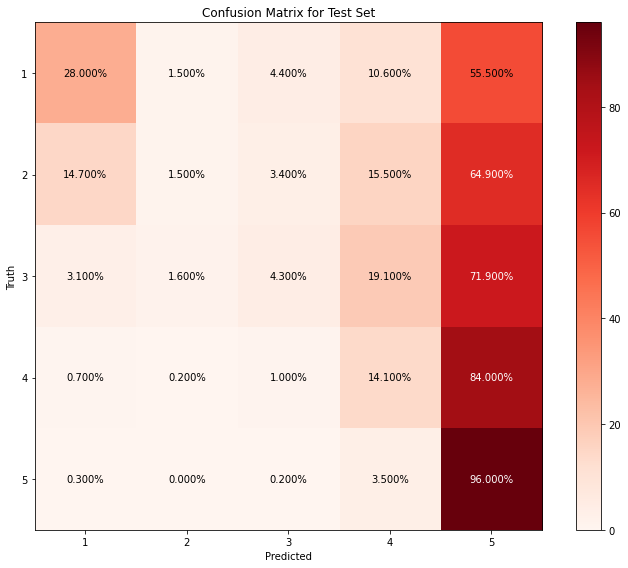

In [129]:
confusion_train = confusion_matrix(y_test, y_pred)
confusion_train = confusion_train.astype("float") / \
                   confusion_train.sum(axis=1)[:, np.newaxis]
confusion_train = np.around(confusion_train, decimals=3)*100
f, axes = plt.subplots(figsize=(10,8))
im = axes.imshow(confusion_train, interpolation="nearest", cmap=plt.cm.Reds)
axes.figure.colorbar(im, ax=axes)
axes.set(title="Confusion Matrix for Test Set", \
         xticks=np.arange(confusion_train.shape[1]), \
         yticks=np.arange(confusion_train.shape[0]), \
         xticklabels=range(1, 6), yticklabels=range(1, 6), \
         xlabel="Predicted", ylabel="Truth")
threshold = confusion_train.max()/1.5
for i in range(confusion_train.shape[0]):
    for j in range(confusion_train.shape[1]):
        axes.text(j, i, f"{confusion_train[i, j]:.3f}%",
                ha="center", va="center",
                color="white" if confusion_train[i, j] > threshold else "black")
f.tight_layout()
plt.show()

Building on the balanced Dataset

In [130]:
X = trimmed_df.iloc[:, :-1]
y = trimmed_df.iloc[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.25, random_state=42)

In [131]:
y_train_shifted = y_train-1
y_test_shifted = y_test-1
train_set = xgb.DMatrix(X_train, label=y_train_shifted)
test_set = xgb.DMatrix(X_test, label=y_test_shifted)
y_pred = boost.predict(test_set)
y_pred = y_pred.argmax(axis=1)
y_pred = y_pred+1
accuracy = metrics.accuracy_score(y_test, y_pred)
f1_score = metrics.f1_score(y_test, y_pred, average="micro")
print(f"Balanced Test Set Accuracy: {accuracy*100:.3f}%")
print(f"Balanced Test Set F1 Score: {f1_score:.3f}")

Balanced Test Set Accuracy: 85.714%
Balanced Test Set F1 Score: 0.857


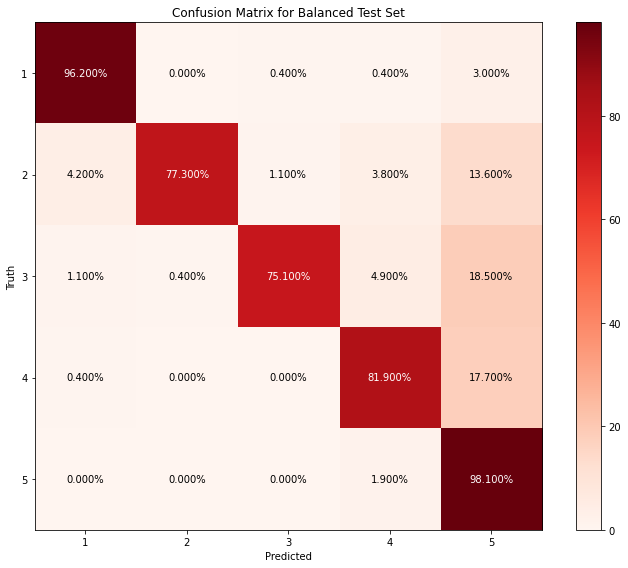

In [132]:
confusion_train = confusion_matrix(y_test, y_pred)
confusion_train = confusion_train.astype("float") / \
                   confusion_train.sum(axis=1)[:, np.newaxis]
confusion_train = np.around(confusion_train, decimals=3)*100
f, axes = plt.subplots(figsize=(10,8))
im = axes.imshow(confusion_train, interpolation="nearest", cmap=plt.cm.Reds)
axes.figure.colorbar(im, ax=axes)
axes.set(title="Confusion Matrix for Balanced Test Set", \
         xticks=np.arange(confusion_train.shape[1]), \
         yticks=np.arange(confusion_train.shape[0]), \
         xticklabels=range(1, 6), yticklabels=range(1, 6), \
         xlabel="Predicted", ylabel="Truth")
threshold = confusion_train.max()/1.5
for i in range(confusion_train.shape[0]):
    for j in range(confusion_train.shape[1]):
        axes.text(j, i, f"{confusion_train[i, j]:.3f}%",
                ha="center", va="center",
                color="white" if confusion_train[i, j] > threshold else "black")
f.tight_layout()
plt.show()

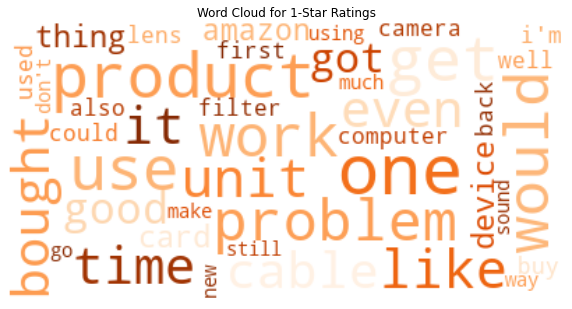

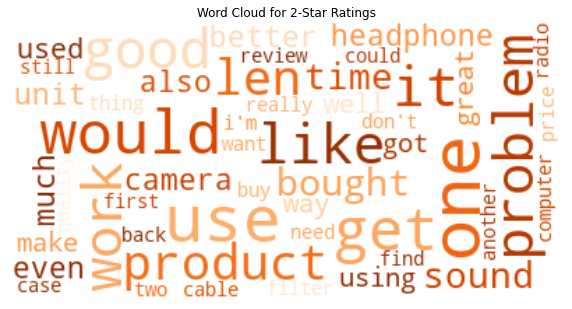

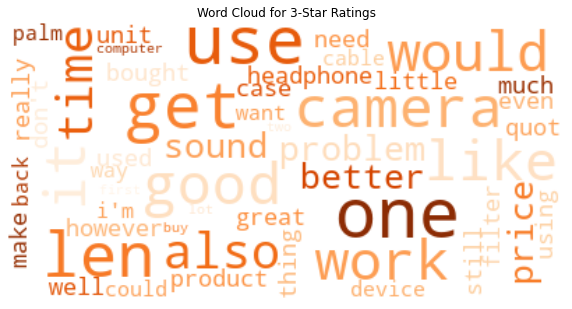

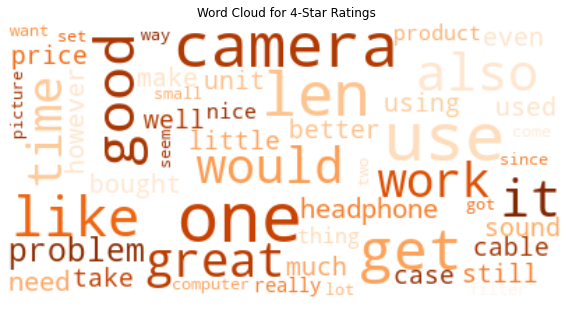

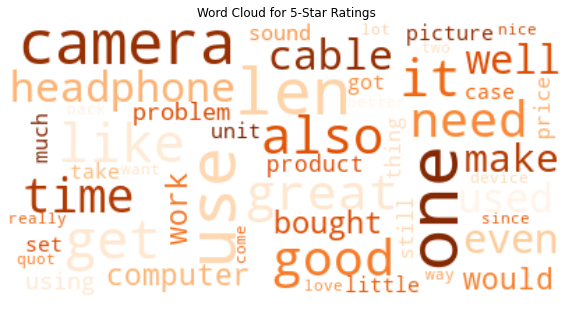

In [133]:
from wordcloud import WordCloud
wordcloud = WordCloud(stopwords = set(stop_words), min_font_size=10, \
                      max_font_size=50, max_words=50, \
                      background_color="white", colormap = "Oranges")
one_star_text = " ".join(df[df["overall"]==1]["reviewText"].values).lower()
two_star_text = " ".join(df[df["overall"]==2]["reviewText"].values).lower()
three_star_text = " ".join(df[df["overall"]==3]["reviewText"].values).lower()
four_star_text = " ".join(df[df["overall"]==4]["reviewText"].values).lower()
five_star_text = " ".join(df[df["overall"]==5]["reviewText"].values).lower()
text_list = [one_star_text, two_star_text, three_star_text, \
             four_star_text, five_star_text]
for index, text in enumerate(text_list):
    f, axes = plt.subplots(figsize=(10,7))
    wordcloud.generate(text)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.title(f"Word Cloud for {index+1}-Star Ratings")
    plt.axis("off")
    plt.show()